In [143]:
import numpy, random, math
from scipy.optimize import minimize
import matplotlib.pyplot as plt
import numpy as np

In [144]:
def kernel(type,x1,x2,p=1,sigma=1):
    if (type == "linear"):
        return np.dot(x1,x2)
    elif(type =="poly"):
        return (np.dot(x1, x2) + 1) ** p
    else:
        return(np.exp(-np.linalg.norm(x1-x2)**2/2*sigma**2))
    
x1 = np.array([1, 2])
x2 = np.array([3, 4])

print(kernel("linear", x1, x2))  
print(kernel("poly", x1, x2, p=2))  
print(kernel("rbf", x1, x2, sigma=1))  

11
144
0.018315638888734165


In [145]:
classA = numpy.concatenate(
	(numpy.random.randn(10, 2) * 0.2 + [1.5, 0.5],
	 numpy.random.randn(10, 2) * 0.2 + [-1.5, 0.5]))
classB = numpy.random.randn(20, 2) * 0.2 + [0.0, -0.5]
inputs = numpy.concatenate((classA, classB))
targets = numpy.concatenate(
	(numpy.ones(classA.shape[0]),
	 -numpy.ones(classB.shape[0])))
N = inputs.shape[0]  # Number of rows (samples)
permute = list(range(N))
random.shuffle(permute)
inputs = inputs[permute, :]
targets = targets[permute]

In [146]:
print("Inputs shape:", inputs.shape)
print("Targets shape:", targets.shape)
print("Sample inputs:\n", inputs[:5])
print("Sample targets:\n", targets[:5])


Inputs shape: (40, 2)
Targets shape: (40,)
Sample inputs:
 [[ 0.31813931 -0.53594184]
 [-0.05623037 -0.6845161 ]
 [-0.07127296 -0.6064148 ]
 [-0.19846118 -0.62092235]
 [ 1.46059874  0.56088179]]
Sample targets:
 [-1. -1. -1. -1.  1.]


In [147]:
#parameters
C = 0.1
threshold = 1e-5
kernel_type1 = 'rbf'
kernel_type2 = 'linear'
kernel_type3 = 'poly'
P = 3
S = 2

In [148]:
P_linear = np.zeros((N, N))
P_poly = np.zeros((N, N))
P_rbf = np.zeros((N, N))

for i in range(N):
    for j in range(N):
        P_linear[i, j] = targets[i] * targets[j] * kernel('linear', inputs[i], inputs[j])
        P_poly[i, j] = targets[i] * targets[j] * kernel('poly', inputs[i], inputs[j], p=P)  # Assuming p=2 for polynomial kernel
        P_rbf[i, j] = targets[i] * targets[j] * kernel('rbf', inputs[i], inputs[j], sigma=S)  # Assuming sigma=1 for RBF kernel

print("Sample P_linear values:", P_linear[:3, :3])
print("Sample P_poly values:", P_poly[:3, :3])
print("Sample P_rbf values:", P_rbf[:3, :3])


Sample P_linear values: [[0.38844628 0.34897173 0.30232833]
 [0.34897173 0.47172415 0.4191084 ]
 [0.30232833 0.4191084  0.37281874]]
Sample P_poly values: [[2.67662323 2.45475722 2.20882581]
 [2.45475722 3.18771326 2.8578979 ]
 [2.20882581 2.8578979  2.58725715]]
Sample P_rbf values: [[1.         0.72292201 0.73109147]
 [0.72292201 1.         0.98742751]
 [0.73109147 0.98742751 1.        ]]


In [149]:
def objective(alpha):
    return (1/2*np.dot(alpha,np.dot(P,alpha))-np.sum(alpha))

def zerofun(alpha):
    return np.dot(alpha, targets)

ret = minimize(objective, np.zeros(N), bounds=[(0, C) for b in range(N)], constraints={'type':'eq', 'fun':zerofun})

a = ret['x']
if ret['success']:
    print("Optimization successful!")
    print("Optimal alpha:", a)
else:
    print("Optimization failed!")

print("Constraint result:", zerofun(a))
print("Initial objective value:", objective(np.zeros(N)))
print("Objective value at solution:", objective(a))



Optimization successful!
Optimal alpha: [0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1
 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1
 0.1 0.1 0.1 0.1]
Constraint result: 3.83026943495679e-15
Initial objective value: 0.0
Objective value at solution: -3.3999999999996313


In [150]:
non_zero_alpha = []
for i in range(N):
    if a[i] > threshold:
        non_zero_alpha.append((a[i], inputs[i], targets[i]))

a_non_zero = []
input_non_zero = []
target_non_zero = []
for i in range(len(non_zero_alpha)):
    a, b, c = non_zero_alpha[i]
    a_non_zero.append(a)
    input_non_zero.append(b)
    target_non_zero.append(c)

alpha_sv, s, t = non_zero_alpha[0]
print(t)

b_linear = np.sum([
    a_non_zero[i] * target_non_zero[i] * kernel('linear', s, input_non_zero[i])
    for i in range(len(a_non_zero))
]) - t

b_poly = np.sum([
    a_non_zero[i] * target_non_zero[i] * kernel('poly', s, input_non_zero[i], p=P)
    for i in range(len(a_non_zero))
]) - t

b_rbf = np.sum([
    a_non_zero[i] * target_non_zero[i] * kernel('rbf', s, input_non_zero[i], sigma=S)
    for i in range(len(a_non_zero))
]) - t

print("b_linear:", b_linear)
print("b_poly:", b_poly)
print("b_rbf:", b_rbf)

def indicate(x, kernel_type):
    total = 0
    if kernel_type == 'linear':
        b = b_linear
        for i in range(len(a_non_zero)):
            k_value = kernel(kernel_type, x, input_non_zero[i])
            term = a_non_zero[i] * target_non_zero[i] * k_value
            print(f"SV[{i}] Contribution: a={a_non_zero[i]}, t={target_non_zero[i]}, K={k_value}, term={term}")
            total += term
    elif kernel_type == 'poly':
        b = b_poly
        for i in range(len(a_non_zero)):
            k_value = kernel(kernel_type, x, input_non_zero[i],p=P)
            term = a_non_zero[i] * target_non_zero[i] * k_value
            print(f"SV[{i}] Contribution: a={a_non_zero[i]}, t={target_non_zero[i]}, K={k_value}, term={term}")
            total += term
    elif kernel_type == 'rbf':
        b = b_rbf
        for i in range(len(a_non_zero)):
            k_value = kernel(kernel_type, x, input_non_zero[i],sigma=S)
            term = a_non_zero[i] * target_non_zero[i] * k_value
            print(f"SV[{i}] Contribution: a={a_non_zero[i]}, t={target_non_zero[i]}, K={k_value}, term={term}")
            total += term
    else:
        raise ValueError("Unknown kernel type")

    
    total -= b
    print(f"indicate({x}): {total}")
    return total


-1.0
b_linear: -0.042629581112324955
b_poly: -1.3502863698033325
b_rbf: -0.409509569890798


In [151]:
sv_point = input_non_zero[0]  # 随机选一个支持向量
sv_target = target_non_zero[0]  # 对应的目标值

output_linear = indicate(sv_point, 'linear')
output_poly = indicate(sv_point, 'poly')
output_rbf = indicate(sv_point, 'rbf')

print(f"Support vector: {sv_point}")
print(f"Target value: {sv_target}")
print(f"indicate output (linear): {output_linear}")
print(f"Difference from target (linear): {abs(output_linear - sv_target)}")
print(f"indicate output (poly): {output_poly}")
print(f"Difference from target (poly): {abs(output_poly - sv_target)}")
print(f"indicate output (rbf): {output_rbf}")
print(f"Difference from target (rbf): {abs(output_rbf - sv_target)}")


SV[0] Contribution: a=0.09999999999998677, t=-1.0, K=0.38844627979990853, term=-0.03884462797998571
SV[1] Contribution: a=0.1, t=-1.0, K=0.3489717315642021, term=-0.03489717315642021
SV[2] Contribution: a=0.09999999999996777, t=-1.0, K=0.3023283337405371, term=-0.030232833374043963
SV[3] Contribution: a=0.09999999999999164, t=-1.0, K=0.2696399662698656, term=-0.026963996626984302
SV[4] Contribution: a=0.09999999999997682, t=1.0, K=0.1640738565332336, term=0.016407385653319555
SV[5] Contribution: a=0.1, t=1.0, K=-0.5229433988819384, term=-0.05229433988819385
SV[6] Contribution: a=0.099999999999988, t=-1.0, K=0.3329825733300022, term=-0.033298257332996226
SV[7] Contribution: a=0.09999999999998703, t=-1.0, K=-0.03378129193460005, term=0.0033781291934595666
SV[8] Contribution: a=0.09999999999998652, t=-1.0, K=0.2103163777725224, term=-0.021031637777249406
SV[9] Contribution: a=0.0999999999999849, t=1.0, K=-0.6916128218370008, term=-0.06916128218368964
SV[10] Contribution: a=0.0999999999999

SV[0] Contribution: a=0.09999999999998677, t=-1.0, K=0.5530708184802349, term=-0.055307081848016165
SV[1] Contribution: a=0.1, t=-1.0, K=3.0192162435957286, term=-0.30192162435957287
SV[2] Contribution: a=0.09999999999996777, t=-1.0, K=2.7820239621389424, term=-0.27820239621380455
SV[3] Contribution: a=0.09999999999999164, t=-1.0, K=3.4759952889397603, term=-0.34759952889394696
SV[4] Contribution: a=0.09999999999997682, t=1.0, K=-9.54652087438543, term=-0.9546520874383218
SV[5] Contribution: a=0.1, t=1.0, K=7.273380824463278, term=0.7273380824463278
SV[6] Contribution: a=0.099999999999988, t=-1.0, K=4.122112756720986, term=-0.4122112756720491
SV[7] Contribution: a=0.09999999999998703, t=-1.0, K=1.397954372357767, term=-0.13979543723575857
SV[8] Contribution: a=0.09999999999998652, t=-1.0, K=2.1672742646850995, term=-0.21672742646848073
SV[9] Contribution: a=0.0999999999999849, t=1.0, K=6.213706606787301, term=0.6213706606786362
SV[10] Contribution: a=0.09999999999998906, t=1.0, K=-11.6

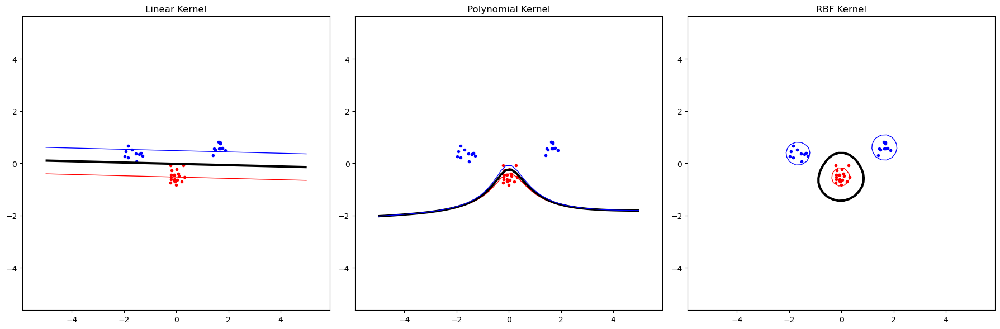

In [152]:
plt.figure(figsize=(18, 6))
xgrid = numpy.linspace(-5, 5)
ygrid = numpy.linspace(-4, 4)
# Linear kernel
plt.subplot(1, 3, 1)
plt.plot([p[0] for p in classA], [p[1] for p in classA], 'b.')
plt.plot([p[0] for p in classB], [p[1] for p in classB], 'r.')
plt.axis('equal')
plt.title('Linear Kernel')
grid_linear = np.array([[indicate(np.array([x, y]), 'linear') for x in xgrid] for y in ygrid])
plt.contour(xgrid, ygrid, grid_linear, levels=(-1.0, 0.0, 1.0), colors=('red', 'black', 'blue'), linewidths=(1, 3, 1))

# Polynomial kernel
plt.subplot(1, 3, 2)
plt.plot([p[0] for p in classA], [p[1] for p in classA], 'b.')
plt.plot([p[0] for p in classB], [p[1] for p in classB], 'r.')
plt.axis('equal')
plt.title('Polynomial Kernel')
grid_poly = np.array([[indicate(np.array([x, y]), 'poly') for x in xgrid] for y in ygrid])
plt.contour(xgrid, ygrid, grid_poly, levels=(-1.0, 0.0, 1.0), colors=('red', 'black', 'blue'), linewidths=(1, 3, 1))

# RBF kernel
plt.subplot(1, 3, 3)
plt.plot([p[0] for p in classA], [p[1] for p in classA], 'b.')
plt.plot([p[0] for p in classB], [p[1] for p in classB], 'r.')
plt.axis('equal')
plt.title('RBF Kernel')
grid_rbf = np.array([[indicate(np.array([x, y]), 'rbf') for x in xgrid] for y in ygrid])
plt.contour(xgrid, ygrid, grid_rbf, levels=(-1.0, 0.0, 1.0), colors=('red', 'black', 'blue'), linewidths=(1, 3, 1))

plt.tight_layout()
plt.savefig('svmplot_kernels.pdf')
plt.show()